# Deep Dive on HDBs in Singapore
## Introduction
### EDA
A data science project often begins with Exploratory Data Analysis (EDA). EDA is like taking the first step on a treasure hunt. We use EDA to find patterns, unusual things, and interesting clues that are hiding in the data. It's like using a map before going on an adventure. EDA provides insight about the data and helps us come up with plans for tackling our data science project.
### HDB
In Singapore, HDBs (Housing and Development Board flats) are homes that the majority of people live in. They are apartments or flats that the government builds and rents or sells to Singaporeans. These homes provide affordable housing for many Singaporeans and offer various facilities and amenities like parks, schools, and markets nearby.
### This Project 
This project aims to build a model that allows you to choose a HDB on a map and predict the current (or future) resale price of it based on historical trends + other data such as population and GDP. 



## Loading the Data 

In [1]:
# DATA MANIPULATION
import pandas as pd
import numpy as np
#import statsmodels

# DATA VISUALIZATION
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
#make file path variable so that all we need is to change this if we move notebook location
file_path = '../data/processed/final_HDB_for_model.parquet.gzip'

#read data into csv
df = pd.read_parquet(file_path)

#check to see if it loaded correctly
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 890376 entries, 0 to 890375
Data columns (total 27 columns):
 #   Column                                                                         Non-Null Count   Dtype         
---  ------                                                                         --------------   -----         
 0   town                                                                           890376 non-null  object        
 1   flat_type                                                                      890376 non-null  object        
 2   block                                                                          890376 non-null  object        
 3   street_name                                                                    890376 non-null  object        
 4   storey_range                                                                   890376 non-null  object        
 5   floor_area_sqm                                                          

In [3]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
floor_area_sqm,890376.0,96.32553,31.0,73.0,93.0,114.0,307.0,25.622407
lease_commence_date,890376.0,1988.298364,1966.0,1981.0,1986.0,1996.0,2022.0,10.371863
resale_price,890376.0,318533.056273,5000.0,195000.0,296000.0,412000.0,1500000.0,164940.518466
sold_year_month,890376,2006-05-26 12:54:41.425375,1990-01-01 00:00:00,1999-01-01 00:00:00,2005-03-01 00:00:00,2013-06-01 00:00:00,2023-09-01 00:00:00,NaN
sold_year,890376.0,2005.937143,1990.0,1999.0,2005.0,2013.0,2023.0,9.05899
sold_remaining_lease,890376.0,81.36122,42.0,75.0,83.0,90.0,101.0,10.572287
max_floor_lvl,890376.0,13.861731,1.0,12.0,12.0,16.0,50.0,5.054816
5 year bond yields,890376.0,2.503039,0.31,1.56,2.57,3.38,5.49,1.151273
GDPm (Current Prices),890376.0,68572.590837,16669.5,36198.8,51193.3,95558.7,164868.1,40250.730768
GDP per capita,890376.0,53341.632176,22901.0,37363.0,47046.0,67444.0,105089.446202,19749.50144


### Remarks on Data Loaded

The dataset contains 890,376 entries with a wide range of features. 

Here's a brief overview of some key numerical columns:
- **floor_area_sqm**: Ranges from 31 to 307 square meters.
- **lease_commence_date**: Ranges from 1966 to 2022.
- **resale_price**: Ranges from $5,000 to $1,500,000.
- **year**: Ranges from 1990 to 2023.
- **ResidentPopulation**: Ranges from about 2.74 million to 4.15 million.
- **Missing Values**: There are no columns with missing values in the dataset.



## Data Visualization  

### Counts of Resale Flats by Town, Flat Type, and Flat Model

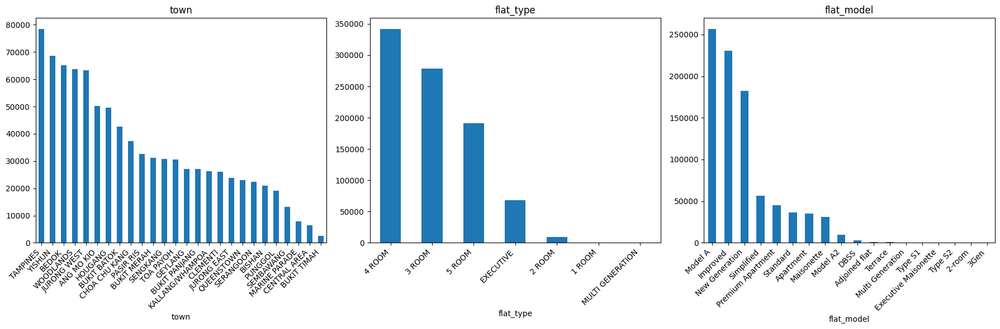

In [4]:
# Categorical Data Analysis
categorical_columns = ['town', 'flat_type', 'flat_model']

# Plotting distributions for categorical variables
plt.figure(figsize=(18, 6))

for i, column in enumerate(categorical_columns, 1):
    plt.subplot(1, 3, i)
    df[column].value_counts().plot(kind='bar')
    #plt.yscale("log")
    plt.title(column)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()

plt.show()

**Observations**
- Town bar graph shows the frequency of properties across different towns. Some towns like Tampines and Yishun appear more frequently than others, indicating a higher number of transactions or listings in those areas.
- Flat type graph shows that 4 room HDB are the most resold type of HDB.
- Flat model graph shows that the vast majority of flats in singapore are of either Model A, Improved or New Generation type. Other models do not appear as much. 

### Boxplots of resale prices per year

In [5]:
# Create a box plot
fig = px.box(df, x='sold_year', y='resale_price',
             labels={'resale_price': 'Resale Price', 'year': 'Year'},
             title='Box Plot of Resale Price by Year')

# Set the x-axis tick mode to 'array' and set tick values explicitly
fig.update_xaxes(tickmode='array', tickvals=df['sold_year'].unique())

# Change the theme
fig.update_layout(template='plotly_dark')

**Observation**
- The graph is a box plot showing HDB resale prices from 1990 to 2023.
- The line in each box is the median price
- Box edges show where most prices fall each year.
- Lines sticking out show the normal highest and lowest prices.
- Dots far from the boxes are the outliers.
- The trend shows widgets becoming more valuable over time.
- Early on, from 1998 to around 2006, HDBs have a pretty tight price range.
- From 2004 onwards, you see those prices start to grow, with a significant increase in range and median price. 
- Outliers seem to grow more over time, often fetching prices way above the norm.

### Counts of each flat type sold over the years

In [6]:
# Group the data by 'year' and 'flat_type' and count the number of occurrences
flat_type_counts = df.groupby(['sold_year', 'flat_type']).size().reset_index(name='count')

# Calculate the sum of all sold properties for each year
total_sold_per_year = df.groupby('sold_year').size().reset_index(name='total_sold')

# Merge the total sold counts back into the flat_type_counts DataFrame
flat_type_counts = pd.merge(flat_type_counts, total_sold_per_year, on='sold_year', how='left')

# Create a line graph using Plotly Express
fig = px.line(flat_type_counts, x='sold_year', y='count', color='flat_type',
              color_discrete_sequence=px.colors.qualitative.Light24, markers=True,
              labels={'count': 'Count', 'year': 'Year'},
              title='Number of each type of flat sold per year')

# Add a line for the total sold properties
fig.add_trace(px.line(flat_type_counts, x='sold_year', y='total_sold', labels='Total', markers=True,).data[0])

# Change yaxis scale
fig.update_yaxes(type='log')

# Change the theme
fig.update_layout(template='plotly_dark')

**Observation**
- Total sold from the year is missing from the legend
- 4 Room flats consistently have the highest sales count across the years.
- Sales of 1 Room and Multi Generation flats are the lowest.
- Sales of 2, 3, 4, 5 Room & Executive flats show relative stability with fluctuations but no clear long-term upward or downward trend.
- There's a slight dip in sales for most flat types around 2021, except for 2 Room flats.

### Median resale price of each type of flat over the years

In [7]:
# Group the data by 'year' and 'flat_type' and count the number of occurrences
flat_type_median = df.groupby(['sold_year', 'flat_type'])['resale_price'].median().reset_index(name='median_price')

# Create a line graph using Plotly Express
fig = px.line(flat_type_median, x='sold_year', y='median_price', color='flat_type',
              color_discrete_sequence=px.colors.qualitative.Light24, markers=True,
              labels={'median_price': 'Median Price', 'year': 'Year'},
              title='Median resale price of each type of flat over the years')



# Change the theme
fig.update_layout(template='plotly_dark')
#fig.update_xaxes(rangeslider_visible=True)

**Observation** 
- All flat types show an overall increasing trend in median resale price over time. 
- The slight dip in prices from '96 - '97 are possibly caused by the cooling measures introduced and the asian financial crisis. Likewise with the dip in 2013 when more cooling measures were introduced*.
- The 5 Room and Executive flats show the most significant increase in median price, particularly from the late 2000s onwards.
- Multi Generation flats show a steep increase in median price starting around the late 2000s, surpassing all other flat types by 2025.
- The 1 Room flats have the lowest median resale price across the timeline, with a more gradual increase.
- The price increase rate for 2 Room and 3 Room flats is moderate but consistent.
- The 4 Room flats' median price remains in the mid-range among the flat types and follows a steady growth pattern.

*Source: https://www.businesstimes.com.sg/property/mobile-spotlight/summary-singapores-property-cooling-measures-1996-present-day

### Stacked Bar Graph of Town and Flat Type

In [8]:
# Group the data by 'town' and 'flat_type' and count the number of occurrences
flat_type_town = df.groupby(['town', 'flat_type']).size().reset_index(name='count').sort_values(by=['town'])

# Create the stacked bar graph
fig = px.bar(flat_type_town, x='town', y='count', color='flat_type',
             color_discrete_sequence=px.colors.qualitative.Light24,
             labels={'count': 'Count', 'town': 'Town'},
             title='Stacked Bar Graph of Town and Flat Types Sold')

# Change the theme
fig.update_layout(template='plotly_dark')
#fig.update_yaxes(type='log')

**Observation**
- 3 & 4 Room flats have a significant presence in almost all towns.
- 4 Room flats also contribute a large portion to the bars, indicating their popularity.
- 5 Room and Executive flats are more prevalent in certain towns like Tampines & Woodlands.
- Multi Generation and 1 Room flats have little to no representation across all towns.
- The highest counts of flats are in towns like Bedok, Jurong West, Tampines, Woodlands, and Yishun.
- Towns like Bukit Timah, Marine Parade, and Central Area have significantly lower counts of flats.

### Mean Prices per Year Broken Down by Town

In [9]:
#create df of mean prices by year
mean_town_price = df.groupby(['town', 'sold_year'])['resale_price'].mean().to_frame().sort_values(by=['town', 'sold_year']).reset_index()

# Create the line plot using Plotly
fig = px.line(mean_town_price, x='sold_year', y='resale_price', color='town', markers=True,
              color_discrete_sequence=px.colors.qualitative.Light24,
              labels={'resale_price': 'Mean Resale Price', 'sold_year': 'Sold Year'},
              title='Mean Resale Price by Town Over Time')

# Change the theme + add range slider
fig.update_layout(template='plotly_dark')
fig.update_xaxes(rangeslider_visible=True)

**Observation**
- Prices follow the same trends mentioned in the Median resale price graph. 
- Post-2006, there is a renewed increase in resale prices across all towns.
- Bukit Timah, Bishan and Central Area display the highest mean resale prices.
- Flats in Central area show a significant jump in 2015. This could be caused by the introduction of new flats for resale in the town. 
- Yishun shows one of the lowest mean resale prices among the towns listed, although it follows the same upward trend.


### Median Prices per Year Broken Down by Town

In [10]:
#create df of median prices by year
median_town_price = df.groupby(['town', 'sold_year'])['resale_price'].median().to_frame().sort_values(by=['town', 'sold_year']).reset_index()

# Create the line plot using Plotly
fig = px.line(median_town_price, x='sold_year', y='resale_price', color='town', markers=True,
              color_discrete_sequence=px.colors.qualitative.Light24,
              labels={'resale_price': 'Median Resale Price', 'sold_year': 'Sold Year'},
              title='Median Resale Price by Town Over Time')

# Change the theme + add range slider
fig.update_layout(template='plotly_dark')
fig.update_xaxes(rangeslider_visible=True)

**Observation**
- When taking the median instead of the mean, the results are somewhat similar, with a few exceptions.
- Prices in Bukit Timah are still the highest followed by Bishan and now Bukit Merah, instead of Central Area. 
- Prices for flats in Central Area have periodic spikes. 
- Flats in Ang Mo Kio have the lowest median prices 2019 onwards, whereas Yishun's prices have been increasing at a faster rate.

### Number of MRT Station in each Town

In [11]:
# Getting mean prices in each town from last 3 years
mean_prices = df[df['sold_year'] >= 2020].groupby('town')['resale_price'].mean().sort_values(ascending=False).to_frame().reset_index()

# Counting unique mrt stations in each town
unique_mrt_per_town = df.groupby('town')['most_closest_mrt'].nunique().sort_values(ascending=False).to_frame().reset_index()

#merge dataframes and rename column
prices_mrt_df = unique_mrt_per_town.merge(mean_prices, on='town')
prices_mrt_df.columns = prices_mrt_df.columns.str.replace("resale_price", "mean_resale_price")

# Creating a Plotly bar plot
fig = px.bar(prices_mrt_df, x='town', y='most_closest_mrt',
             text_auto=True, color = 'mean_resale_price',
             labels={'most_closest_mrt': 'Number of Unique MRT Stations',
                     'town': 'Town',
                     'mean_resale_price': 'Mean Price 2020 - 2023'},
             title='Number of Unique Closest MRT Stations per Town')

fig.update_layout(template='plotly_dark')

**Observation**
- As expected, towns closer to the central area / CBD have more MRT stations located within them. 
- However there is no correlation between the mean price of a HDB and the number of MRTs in the town. 
- The towns themselves are a greater predictor of price.

### Mean Floor Area by Flat Type Over Time

In [12]:
#create df of mean floor area by year
mean_floor_area = df.groupby(['flat_type', 'lease_commence_date'])['floor_area_sqm'].mean().to_frame().sort_values(by=['lease_commence_date', 'flat_type']).reset_index()

# Create the line plot using Plotly
fig = px.line(mean_floor_area, x='lease_commence_date', y='floor_area_sqm', color='flat_type', markers=True,
              color_discrete_sequence=px.colors.qualitative.Light24,
              labels={'floor_area_sqm': 'Mean Floor Area', 'lease_commence_date': 'Year Made'},
              title='Mean Floor Area by Flat Type Over Time')

# Change the theme + add range slider
fig.update_layout(template='plotly_dark')

**Observation**
- As expected, all flat types can be distinctly segregated based on their floor area
- The largest flats are observed in the multi-generation flats, followed by executive. But since multi-generation flats seem to have been discontinued, it could be posited that executive flats took over the role multi-generation flats were designed for. 
- Interesting to note that one room flats were only made in one year and never again. 
- The building of two room flats was sporadic from the mid eighties to the late two thousands before becoming consistent, indicating a change in market demand for such flats. 
- Two & three room flat sizes have not fluctuated as much as four, five room, and executive flats over time. 

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 890376 entries, 0 to 890375
Data columns (total 27 columns):
 #   Column                                                                         Non-Null Count   Dtype         
---  ------                                                                         --------------   -----         
 0   town                                                                           890376 non-null  object        
 1   flat_type                                                                      890376 non-null  object        
 2   block                                                                          890376 non-null  object        
 3   street_name                                                                    890376 non-null  object        
 4   storey_range                                                                   890376 non-null  object        
 5   floor_area_sqm                                                          

#### Line plot of the oldest flats in singapore 

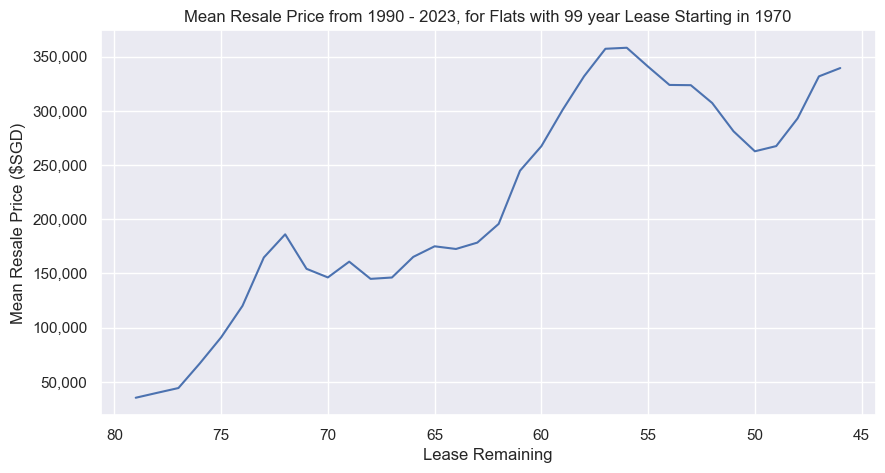

In [57]:
oldest = df['lease_commence_date'].min()
df_earliest_lease = df[df['lease_commence_date'] == oldest + 4 ]
lease_remaining = str(oldest + 4)

mean_resale_price = df_earliest_lease.groupby(['','sold_year'])['resale_price'].mean().reset_index()

from matplotlib.ticker import FuncFormatter
def with_commas(x, pos):
    return "{:,}".format(int(x))

# Create the line plot
plt.figure(figsize=(10, 5))
sns.lineplot(data=mean_resale_price, x='sold_remaining_lease', y='resale_price')
sns.set_theme(style = 'darkgrid')
plt.title('Mean Resale Price from 1990 - 2023, for Flats with 99 year Lease Starting in ' + lease_remaining)
plt.xlabel('Lease Remaining')
plt.ylabel('Mean Resale Price ($SGD)')
plt.gca().invert_xaxis()
plt.gca().yaxis.set_major_formatter(FuncFormatter(with_commas))
plt.show()

### Correlation Coefficient of Data 

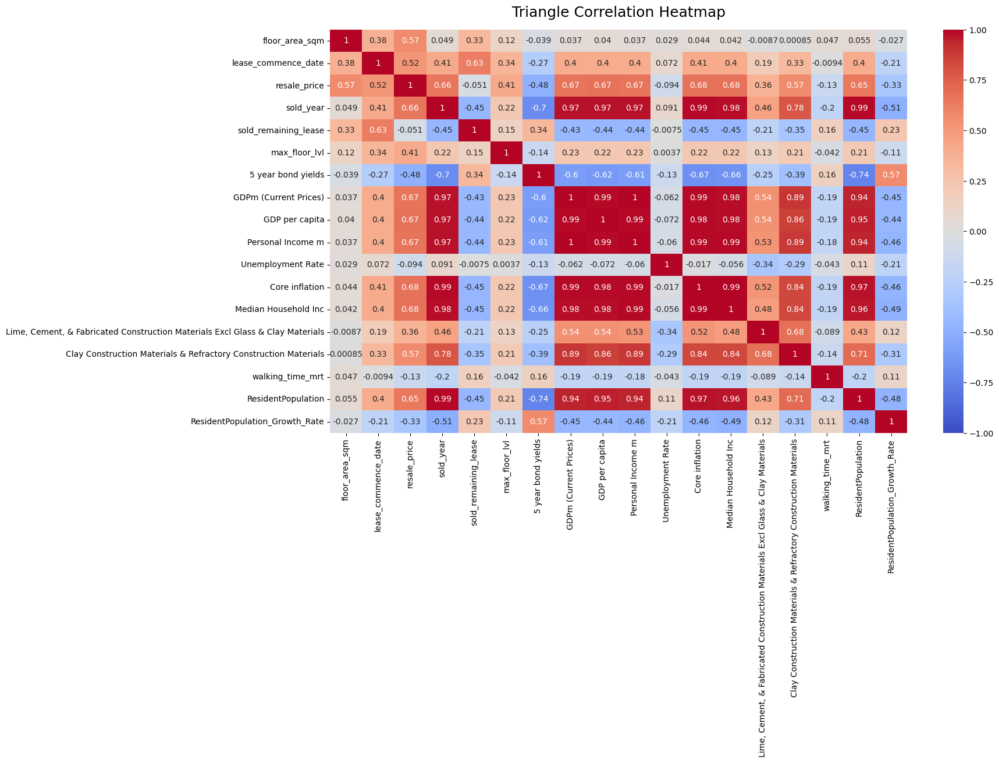

In [13]:
plt.figure(figsize=(16, 9))
heatmap = sns.heatmap(df.select_dtypes(include=np.number).corr(), vmin=-1, vmax=1, annot=True, cmap='coolwarm')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

**Observation**
- Positive Correlations with Resale Price:
  - Economic Indicators: Core inflation, median household income, GDP per capita, and personal income show strong positive correlations with the resale price. This suggests that as the economy grows and household incomes increase, the resale prices of properties tend to rise.
  - Year/Sold Year: There's a strong positive correlation with the year, indicating that property prices have generally increased over time.
  - Resident Population: A higher resident population is also positively correlated with resale prices, possibly reflecting demand pressures in more populated areas.
- Negative Correlations:
  - 5-Year Bond Yields: A negative correlation suggests that higher interest rates (represented by bond yields) might be associated with lower property prices.
  - Resident Population Growth Rate: Interestingly, a higher growth rate in the resident population negatively correlates with resale prices, possibly due to supply catching up or other factors.
- Other Observations:
  - Floor Area: As expected, larger properties (greater floor area) tend to have higher resale prices.
  - Walking Time to MRT: Longer walking times to MRT stations are slightly negatively correlated with resale prices, indicating the importance of accessibility in property valuation.